In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
import boto3
import pprint
import json
from pandas.io.json import json_normalize
import statistics
import datetime

In [2]:
data = pd.read_csv('/Users/jritz/Desktop/RU/MSCA/Data_Analysis_Visualization/metro_bike_data_dav_jp.csv')

/Applications/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
data.head()

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,112543053,11,1/1/19 2:10,1/1/19 2:21,4208,33.998680,-118.472977,4205,33.993771,-118.453667,12010,365,One Way,Annual Pass,standard
1,112559711,10,1/1/19 7:50,1/1/19 8:00,3005,34.048500,-118.258537,3062,34.047749,-118.243172,12337,365,One Way,Annual Pass,standard
2,112565108,16,1/1/19 9:35,1/1/19 9:51,4214,33.995560,-118.481552,4215,34.014309,-118.491341,5726,365,One Way,Annual Pass,standard
3,112565107,14,1/1/19 9:37,1/1/19 9:51,3035,34.048401,-118.260948,4250,34.030170,-118.280952,6668,365,One Way,Annual Pass,standard
4,112565106,3,1/1/19 9:50,1/1/19 9:53,3006,34.045540,-118.256668,3006,34.045540,-118.256668,6153,365,Round Trip,Annual Pass,standard


In [4]:
data.describe()

,trip_id,duration,start_station,start_lat,start_lon,end_station,end_lat,end_lon,plan_duration
count,5.363000e+05,536300.000000,536300.000000,486820.000000,486820.000000,536300.000000,515712.000000,515712.000000,536300.000000
mean,1.339607e+08,35.518490,3500.407742,34.041433,-118.279245,3547.506166,34.041549,-118.282022,56.760188
std,1.135440e+07,125.223257,633.775470,0.186475,1.304926,645.011724,0.159894,1.109355,106.629682
min,1.125368e+08,1.000000,3000.000000,33.710979,-118.495422,3000.000000,33.710979,-118.495422,1.000000
25%,1.254760e+08,7.000000,3024.000000,34.038609,-118.284103,3030.000000,34.038609,-118.284111,1.000000
50%,1.334037e+08,13.000000,3058.000000,34.046822,-118.258537,3065.000000,34.046810,-118.258537,30.000000
75%,1.427018e+08,25.000000,4286.000000,34.051941,-118.248352,4311.000000,34.051941,-118.248352,30.000000
max,1.568137e+08,1440.000000,4583.000000,55.705528,37.606541,4583.000000,55.705528,37.606541,365.000000


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 536300 entries, 0 to 536299
Data columns (total 15 columns):
trip_id                536300 non-null int64
duration               536300 non-null int64
start_time             536300 non-null object
end_time               536300 non-null object
start_station          536300 non-null int64
start_lat              486820 non-null float64
start_lon              486820 non-null float64
end_station            536300 non-null int64
end_lat                515712 non-null float64
end_lon                515712 non-null float64
bike_id                536300 non-null object
plan_duration          536300 non-null int64
trip_route_category    536300 non-null object
passholder_type        536300 non-null object
bike_type              536300 non-null object
dtypes: float64(4), int64(5), object(6)
memory usage: 61.4+ MB


In [6]:
data.shape

(536300, 15)

In [7]:
data[["start_time", "end_time"]] = data[["start_time", "end_time"]].apply(pd.to_datetime)

/Applications/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


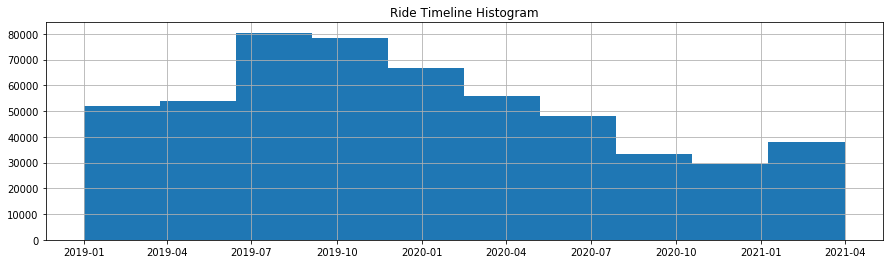

In [8]:
data['start_time'].hist(figsize=(15,4))
plt.title('Ride Timeline Histogram')
plt.show()

In [9]:
data.dropna(subset = ['passholder_type'], how='any', inplace=True)

In [10]:
#create an index of what I want to drop
index_4drop=data[data['passholder_type']=='Testing'].index

#drop that index
data.drop(index_4drop, inplace=True)

In [11]:
uni3=data['passholder_type'].unique()
print(uni3)

['Annual Pass' 'Flex Pass' 'Monthly Pass' 'One Day Pass' 'Walk-up']


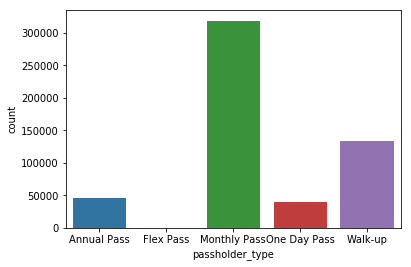

In [12]:
sns.countplot(x='passholder_type', data=data)


In [13]:
data.replace(np.nan, 0, inplace=True)

In [14]:
data.isna().sum()

trip_id                0
duration               0
start_time             0
end_time               0
start_station          0
start_lat              0
start_lon              0
end_station            0
end_lat                0
end_lon                0
bike_id                0
plan_duration          0
trip_route_category    0
passholder_type        0
bike_type              0
dtype: int64

In [15]:
with open('/Users/jritz/Desktop/RU/MSCA/Data_Analysis_Visualization/metro_station.json','r') as datafile:
    gj = json.loads(datafile.read())
    
df_nested_list = json_normalize(gj, record_path =['features'])

In [16]:
print(df_nested_list)

        type    geometry.coordinates geometry.type         properties.addressStreet properties.addressCity properties.addressState properties.addressZipCode  properties.bikesAvailable properties.closeTime  properties.docksAvailable properties.eventEnd properties.eventStart  properties.isEventBased  properties.isVirtual  properties.isVisible  properties.kioskId properties.kioskPublicStatus properties.kioskStatus                                    properties.name properties.notes properties.openTime properties.publicText     properties.timeZone  properties.totalDocks  properties.trikesAvailable properties.kioskConnectionStatus  properties.kioskType  properties.latitude  properties.longitude  properties.hasGeofence  properties.classicBikesAvailable  properties.smartBikesAvailable  properties.electricBikesAvailable  properties.isArchived properties.clientVersion
0    Feature   [-118.25854, 34.0485]         Point                    700 Flower St                   DTLA                      C

In [17]:
df_nested_list.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 35 columns):
type                                 215 non-null object
geometry.coordinates                 215 non-null object
geometry.type                        215 non-null object
properties.addressStreet             215 non-null object
properties.addressCity               215 non-null object
properties.addressState              215 non-null object
properties.addressZipCode            215 non-null object
properties.bikesAvailable            215 non-null int64
properties.closeTime                 215 non-null object
properties.docksAvailable            215 non-null int64
properties.eventEnd                  0 non-null object
properties.eventStart                0 non-null object
properties.isEventBased              215 non-null bool
properties.isVirtual                 215 non-null bool
properties.isVisible                 215 non-null bool
properties.kioskId                   215 non-null in

In [18]:
df_nested_list.rename(columns={'geometry.coordinates':'Coordinates',
                               'geometry.type':'Type',
                               'properties.addressStreet':'Street Address',
                               'properties.addressCity': 'City',
                               'properties.addressState':'State',
                               'properties.addressZipCode':'Zipcode',
                               'properties.bikesAvailable':'Bikes Available',
                               'properties.closeTime':'Close Time',
                               'properties.docksAvailable': 'Docks Available',
                               'properties.kioskId':'Kiosk Id',
                               'properties.kioskPublicStatus':'Kiosk Public Status',
                               'properties.kioskStatus':'Kiosk Status',
                               'properties.name':'Name',
                               'properties.openTime':'Open Time',
                               'properties.publicText':'Public Text',
                               'properties.timeZone':'Time Zone',
                               'properties.totalDocks':'Total Docks',
                               'properties.trikesAvailable':'Trikes Available',
                               'properties.kioskConnectionStatus':'Kiosk Connection Status',
                               'properties.kioskType':'Kiosk Type',
                               'properties.latitude':'Latitude',
                               'properties.longitude':'Longitude',
                               'properties.hasGeofence':'GeoFencing',
                               'properties.classicBikesAvailable':'Classic Bikes Available',
                               'properties.smartBikesAvailable':'Smart Bikes Available',
                               'properties.electricBikesAvailable':'Electric Bikes Available'},inplace=True)

In [19]:
df_nested_list.drop(columns=['type','properties.eventEnd','properties.eventStart','properties.isVirtual','properties.isVisible','properties.notes',
                            'properties.clientVersion'], inplace=True)
df_nested_list.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 28 columns):
Coordinates                 215 non-null object
Type                        215 non-null object
Street Address              215 non-null object
City                        215 non-null object
State                       215 non-null object
Zipcode                     215 non-null object
Bikes Available             215 non-null int64
Close Time                  215 non-null object
Docks Available             215 non-null int64
properties.isEventBased     215 non-null bool
Kiosk Id                    215 non-null int64
Kiosk Public Status         215 non-null object
Kiosk Status                215 non-null object
Name                        215 non-null object
Open Time                   215 non-null object
Public Text                 215 non-null object
Time Zone                   215 non-null object
Total Docks                 215 non-null int64
Trikes Available            215 non-n

In [20]:
df_nested_list.head()

,Coordinates,Type,Street Address,City,State,Zipcode,Bikes Available,Close Time,Docks Available,properties.isEventBased,Kiosk Id,Kiosk Public Status,Kiosk Status,Name,Open Time,Public Text,Time Zone,Total Docks,Trikes Available,Kiosk Connection Status,Kiosk Type,Latitude,Longitude,GeoFencing,Classic Bikes Available,Smart Bikes Available,Electric Bikes Available,properties.isArchived
0,"[-118.25854, 34.0485]",Point,700 Flower St,DTLA,CA,90017,19,05:39:00,11,False,3005,Active,FullService,7th & Flower,05:45:00,,Pacific Standard Time,31,0,Active,1,34.04850,-118.25854,False,18,0,1,False
1,"[-118.25667, 34.04554]",Point,729 S Olive Street,DTLA,CA,90014,7,05:39:00,23,False,3006,Active,FullService,Olive & 8th,05:45:00,,Pacific Standard Time,31,0,Active,1,34.04554,-118.25667,False,7,0,0,False
2,"[-118.25459, 34.05048]",Point,557 S 5th Street,DTLA,CA,90071,5,05:39:00,18,False,3007,Active,FullService,5th & Grand,05:45:00,,Pacific Standard Time,23,0,Active,1,34.05048,-118.25459,False,5,0,0,False
3,"[-118.26273, 34.04661]",Point,865 S Figueroa Street,DTLA,CA,90017,14,05:39:00,0,False,3008,Active,FullService,Figueroa & 9th,05:45:00,,Pacific Standard Time,15,0,Active,1,34.04661,-118.26273,False,14,0,0,False
4,"[-118.25487, 34.03705]",Point,401 East 11th Street,DTLA,CA,90015,8,05:39:00,13,False,3010,Active,FullService,11th & Maple,05:45:00,,Pacific Standard Time,22,0,Active,1,34.03705,-118.25487,False,7,0,1,False


In [21]:
station_df=df_nested_list[['Kiosk Id','Docks Available','Street Address','City','State','Zipcode','Name','Total Docks']].copy()

In [22]:
station_df.head()

,Kiosk Id,Docks Available,Street Address,City,State,Zipcode,Name,Total Docks
0,3005,11,700 Flower St,DTLA,CA,90017,7th & Flower,31
1,3006,23,729 S Olive Street,DTLA,CA,90014,Olive & 8th,31
2,3007,18,557 S 5th Street,DTLA,CA,90071,5th & Grand,23
3,3008,0,865 S Figueroa Street,DTLA,CA,90017,Figueroa & 9th,15
4,3010,13,401 East 11th Street,DTLA,CA,90015,11th & Maple,22


In [23]:
data=pd.merge(data, station_df, how="left", left_on ='start_station', 
              right_on=['Kiosk Id']).rename(columns={'Street Address':'start_address',
                                                    'City':'start_city','State':'start_state','Zipcode':'start_zip',
                                                    'Name':'start_name','Total Docks':'start_total_docks','Docks Available':'start_docks_available'}).drop('Kiosk Id',1)

data=pd.merge(data, station_df, how="left", left_on ='end_station', 
              right_on=['Kiosk Id']).rename(columns={'Street Address':'end_address',
                                                    'City':'end_city','State':'end_state','Zipcode':'end_zip',
                                                    'Name':'end_name','Total Docks':'end_total_docks', 'Docks Available':'end_docks_available'}).drop('Kiosk Id',1)

In [24]:
data.head()

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type,start_docks_available,start_address,start_city,start_state,start_zip,start_name,start_total_docks,end_docks_available,end_address,end_city,end_state,end_zip,end_name,end_total_docks
0,112543053,11,2019-01-01 02:10:00,2019-01-01 02:21:00,4208,33.998680,-118.472977,4205,33.993771,-118.453667,12010,365,One Way,Annual Pass,standard,17.0,529 Rose Ave,Playa Vista,CA,90291,Rose & Rennie,21.0,7.0,923 Venice Blvd,Venice,CA,90291,Venice & Lincoln,16.0
1,112559711,10,2019-01-01 07:50:00,2019-01-01 08:00:00,3005,34.048500,-118.258537,3062,34.047749,-118.243172,12337,365,One Way,Annual Pass,standard,11.0,700 Flower St,DTLA,CA,90017,7th & Flower,31.0,6.0,350 E Third Street,DTLA,CA,90013,3rd & San Pedro,15.0
2,112565108,16,2019-01-01 09:35:00,2019-01-01 09:51:00,4214,33.995560,-118.481552,4215,34.014309,-118.491341,5726,365,One Way,Annual Pass,standard,14.0,Ocean Front Walk at Navy St,Venice,CA,90291,Ocean Front Walk & Navy,26.0,2.0,1621 4th St,Santa Monica,CA,90401,Downtown Santa Monica E Line Station,18.0
3,112565107,14,2019-01-01 09:37:00,2019-01-01 09:51:00,3035,34.048401,-118.260948,4250,34.030170,-118.280952,6668,365,One Way,Annual Pass,standard,13.0,735 S Figueroa Street,DTLA,CA,90017,Figueroa & 8th,23.0,8.0,804 W Adams Blvd,USC,CA,90007,Severance & Adams,15.0
4,112565106,3,2019-01-01 09:50:00,2019-01-01 09:53:00,3006,34.045540,-118.256668,3006,34.045540,-118.256668,6153,365,Round Trip,Annual Pass,standard,23.0,729 S Olive Street,DTLA,CA,90014,Olive & 8th,31.0,23.0,729 S Olive Street,DTLA,CA,90014,Olive & 8th,31.0


In [25]:
data['start_station'].value_counts().describe()

count      303.000000
mean      1769.966997
std       3580.179412
min          1.000000
25%        208.500000
50%        650.000000
75%       1691.000000
max      42175.000000
Name: start_station, dtype: float64

In [26]:
data['start_total_docks'].describe()


count    423328.000000
mean         21.295877
std           6.952363
min           6.000000
25%          15.000000
50%          20.000000
75%          27.000000
max          36.000000
Name: start_total_docks, dtype: float64

In [27]:
data['start_total_docks'].mean()

data['start_total_docks'].fillna((data['start_total_docks'].mean()), inplace=True)


In [28]:
data['end_total_docks'].mean()

data['end_total_docks'].fillna((data['end_total_docks'].mean()), inplace=True)

In [29]:
data['start_docks_available'].mean()

data['start_docks_available'].fillna((data['start_docks_available'].mean()), inplace=True)

In [30]:
data['end_docks_available'].mean()

data['end_docks_available'].fillna((data['end_docks_available'].mean()), inplace=True)

In [31]:
import folium

bike_map=folium.Map([data['start_lat'].values[0],data['start_lon'].values[0]])

for station in data['start_station'].unique():
    lat=data.loc[data['start_station']==station] ['start_lat'].values[0]
    lon=data.loc[data['start_station']==station] ['start_lon'].values[0]
    pu_docks=data.loc[data['start_station']==station] ['start_total_docks'].values[0]
    pu_station=data.loc[data['start_station']==station] ['start_name'].values[0]
    pu=pu_station, pu_docks
    marker=folium.Marker([lat,lon],popup=str(pu), tooltip='Click for Station & Available Docks').add_to(bike_map)
    marker.add_to(bike_map)
bike_map

In [32]:
bike_map.save('/Users/jritz/Desktop/RU/MSCA/Data_Analysis_Visualization/folium-map.html')

In [33]:
# Create label for rides that were charged based on current pricing plan.
def label_charged(duration):
    if duration <= 30:
        return 0
    else:
        return 1

data['charged_ride'] = data['duration'].apply(label_charged)

In [34]:
# Column for hour of day of ride.
data['start_hour'] = data['start_time'].dt.hour

In [35]:
latest_ride_date = data['end_time'].max()
latest_ride_date

Timestamp('2021-04-03 05:02:00')

In [36]:

bike_last_used_id = bike_last_used = data.groupby('bike_id')['end_time'].max().keys().tolist()
bike_last_used_date = data.groupby('bike_id')['end_time'].max().tolist()

In [37]:
# Number of bikes active each month in the past two years.
for month in range(1,25):
    print(month, len([record for record in list(zip(bike_last_used_id,bike_last_used_date)) if 
                      record[1] > latest_ride_date + np.timedelta64(-month, 'M') ]))

1 2395
2 2914
3 3118
4 3173
5 3227
6 3291
7 3558
8 3800
9 4028
10 4244
11 4417
12 4528
13 4637
14 4761
15 4832
16 4904
17 4983
18 5080
19 5197
20 5383
21 5555
22 5655
23 5716
24 5766


In [38]:
# Number of inactive bikes (bikes that haven't been used in the past 6 months)
len([record for record in list(zip(bike_last_used_id,bike_last_used_date)) if 
     record[1] < latest_ride_date + np.timedelta64(-12, 'M') ])

1311

In [39]:
# Number of inactive bikes (bikes that haven't been used in the past 6 months)
len([record for record in list(zip(bike_last_used_id,bike_last_used_date)) if 
     record[1] < latest_ride_date + np.timedelta64(-6, 'M') ])

2548

In [40]:

# Listing out unique values for dummy variables.
data['passholder_type'].unique()

array(['Annual Pass', 'Flex Pass', 'Monthly Pass', 'One Day Pass',
       'Walk-up'], dtype=object)

In [41]:
data['trip_route_category'].unique()

array(['One Way', 'Round Trip'], dtype=object)

In [42]:

# Create dummy variables for passholder type.
one_hot_pass = pd.get_dummies(data['passholder_type']).rename(columns={
    'Flex Pass' : 'flex',
    'Monthly Pass' : 'monthly',
    'One Day Pass' : 'one_day',
    'Walk-up' : 'walk_up',
    'Annual Pass' : 'annual'
})

# Create dummy variables for trip route category.
one_hot_trip_type = pd.get_dummies(data['trip_route_category']).rename(columns = {
    'One Way' : 'one_way',
    'Round Trip' : 'round_trip'
})

rides_df = data.join([one_hot_pass, one_hot_trip_type])

In [43]:

data[data['passholder_type'] == 'Flex Pass'].iloc[1]

trip_id                            112631645
duration                                   8
start_time               2019-01-02 10:28:00
end_time                 2019-01-02 10:36:00
start_station                           3038
start_lat                            34.0468
start_lon                           -118.248
end_station                             3082
end_lat                              34.0465
end_lon                             -118.237
bike_id                                12148
plan_duration                            365
trip_route_category                  One Way
passholder_type                    Flex Pass
bike_type                           standard
start_docks_available                12.2546
start_address                            NaN
start_city                               NaN
start_state                              NaN
start_zip                                NaN
start_name                               NaN
start_total_docks                    21.2959
end_docks_

In [44]:

data.shape

(536300, 31)

In [45]:
import math
# Creates feature for 30 minute blocks that walk-up users have to pay for.
# Creates another feature for 30 minute blocks for passholders that exclude first 30 minute block.
data['time_block_count'] = data['duration'].apply(lambda duration: math.ceil(duration/30))
data['time_block_count_post_free'] = data['duration'].apply(lambda duration: math.ceil(duration/30)) - 1

In [46]:
pprint.pprint(rides_df.dtypes)

trip_id                           int64
duration                          int64
start_time               datetime64[ns]
end_time                 datetime64[ns]
start_station                     int64
start_lat                       float64
start_lon                       float64
end_station                       int64
end_lat                         float64
end_lon                         float64
bike_id                          object
plan_duration                     int64
trip_route_category              object
passholder_type                  object
bike_type                        object
start_docks_available           float64
start_address                    object
start_city                       object
start_state                      object
start_zip                        object
start_name                       object
start_total_docks               float64
end_docks_available             float64
end_address                      object
end_city                         object


In [47]:
data.head()

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type,start_docks_available,start_address,start_city,start_state,start_zip,start_name,start_total_docks,end_docks_available,end_address,end_city,end_state,end_zip,end_name,end_total_docks,charged_ride,start_hour,time_block_count,time_block_count_post_free
0,112543053,11,2019-01-01 02:10:00,2019-01-01 02:21:00,4208,33.998680,-118.472977,4205,33.993771,-118.453667,12010,365,One Way,Annual Pass,standard,17.0,529 Rose Ave,Playa Vista,CA,90291,Rose & Rennie,21.0,7.0,923 Venice Blvd,Venice,CA,90291,Venice & Lincoln,16.0,0,2,1,0
1,112559711,10,2019-01-01 07:50:00,2019-01-01 08:00:00,3005,34.048500,-118.258537,3062,34.047749,-118.243172,12337,365,One Way,Annual Pass,standard,11.0,700 Flower St,DTLA,CA,90017,7th & Flower,31.0,6.0,350 E Third Street,DTLA,CA,90013,3rd & San Pedro,15.0,0,7,1,0
2,112565108,16,2019-01-01 09:35:00,2019-01-01 09:51:00,4214,33.995560,-118.481552,4215,34.014309,-118.491341,5726,365,One Way,Annual Pass,standard,14.0,Ocean Front Walk at Navy St,Venice,CA,90291,Ocean Front Walk & Navy,26.0,2.0,1621 4th St,Santa Monica,CA,90401,Downtown Santa Monica E Line Station,18.0,0,9,1,0
3,112565107,14,2019-01-01 09:37:00,2019-01-01 09:51:00,3035,34.048401,-118.260948,4250,34.030170,-118.280952,6668,365,One Way,Annual Pass,standard,13.0,735 S Figueroa Street,DTLA,CA,90017,Figueroa & 8th,23.0,8.0,804 W Adams Blvd,USC,CA,90007,Severance & Adams,15.0,0,9,1,0
4,112565106,3,2019-01-01 09:50:00,2019-01-01 09:53:00,3006,34.045540,-118.256668,3006,34.045540,-118.256668,6153,365,Round Trip,Annual Pass,standard,23.0,729 S Olive Street,DTLA,CA,90014,Olive & 8th,31.0,23.0,729 S Olive Street,DTLA,CA,90014,Olive & 8th,31.0,0,9,1,0


In [48]:
%store data


Stored 'data' (DataFrame)


In [49]:
pass_groups = data.groupby('passholder_type')
pass_groups.groups.keys()

dict_keys(['Annual Pass', 'Flex Pass', 'Monthly Pass', 'One Day Pass', 'Walk-up'])

In [50]:
agg_pass_groups = pass_groups.agg({
    'trip_id' : 'count',
    'time_block_count' : 'sum',
    'time_block_count_post_free' : 'sum',
    'duration' : 'sum'}).rename(columns = {'trip_id' : 'total_trips', 'walk_up' : 'pay_count_walk_up',
                                        'time_block_count' : 'total_30min_blocks',
                                        'time_block_count_post_free' : 'total_30min_blocks_post_free',
                                        'duration' : 'total_minutes'}).reset_index()
agg_pass_groups['passholder_type'] = ['flex','monthly','one_day','walk_up','annual']
agg_pass_groups.index = agg_pass_groups['passholder_type']
agg_pass_groups = agg_pass_groups.drop('passholder_type',1)
agg_pass_groups

,total_trips,total_30min_blocks,total_30min_blocks_post_free,total_minutes
passholder_type,,,,
flex,45297,55022,9725,734019
monthly,320,481,161,7789
one_day,318356,391915,73559,5912790
walk_up,39083,135776,96693,3490944
annual,133244,366064,232820,8903024


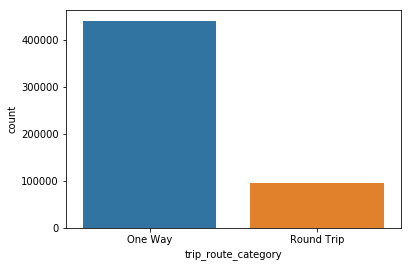

In [51]:
sns.countplot(x="trip_route_category", data=data)


In [52]:
import cufflinks as cf
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()



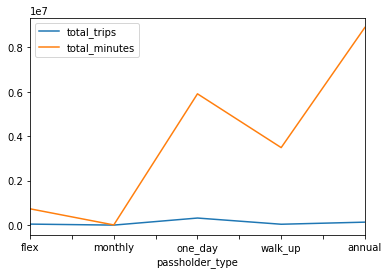

In [53]:
dataset = agg_pass_groups[["total_trips", "total_minutes"]]
dataset.plot()

In [54]:
data.iplot(kind='bar', x=['trip_route_category', 'bike_type'],y='duration')


In [55]:
data.to_csv('data_jp.csv', index=False)

In [56]:
agg_pass_groups.to_csv('agg_pass_groups.csv', index=False)